# import

In [1]:
from PIL import Image
import os
import cv2
import pathlib
import imghdr
import subprocess as sp
import numpy as np
from matplotlib import pyplot as plt

import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications import imagenet_utils
from tensorflow.image import ResizeMethod
import tensorflow_datasets as tfds

from sklearn.metrics import accuracy_score

# mobilenet 첫시도

## 전체식물목록

In [182]:
flower_li = os.listdir('./images')
flower_li.remove('.DS_Store')
flower_li

['버드나무',
 '목련',
 '해바라기',
 '노루오줌',
 '참나리',
 '은행나무',
 '무궁화',
 '할미꽃',
 '단풍나무',
 '꽃향유',
 '물봉선',
 '작약',
 '봉선화',
 '진달래',
 '동백나무',
 '산딸나무',
 '패랭이꽃',
 '수국',
 '토끼풀',
 '국화',
 '은방울꽃',
 '각시붓꽃',
 '밤나무',
 '노루귀',
 '측백나무',
 '수선화',
 '꽃아까시나무',
 '소나무',
 '층꽃나무',
 '벚나무']

### 버드나무

In [213]:
## preprocess_input() 함수 예시
i = tf.keras.layers.Input([224, 224, 3], dtype = tf.uint8)
x = tf.cast(i, tf.float32)
x = tf.keras.applications.mobilenet.preprocess_input(x)

In [215]:
core = tf.keras.applications.MobileNet()

In [216]:
x = core(bd_preprocessed_images)

In [214]:
model = tf.keras.Model(inputs=[i], outputs=[x])

ValueError: Output tensors of a Functional model must be the output of a TensorFlow `Layer` (thus holding past layer metadata). Found: [[1.37390577e-06 1.02422928e-05 1.68435918e-07 ... 1.41688844e-07
  1.16702404e-06 7.68539905e-07]
 [5.31278329e-06 1.79068735e-07 6.82570146e-07 ... 1.21490211e-06
  7.17890373e-07 5.09641929e-09]
 [5.26401573e-06 5.61096385e-06 1.23363964e-06 ... 1.31011539e-05
  5.17643697e-04 2.97943479e-05]
 ...
 [6.34416551e-07 4.95673262e-08 1.11447545e-08 ... 1.01122765e-07
  1.20399889e-07 1.67080105e-09]
 [1.62634901e-08 1.18834731e-09 1.18979981e-08 ... 5.08517708e-08
  3.26469234e-08 1.07944107e-08]
 [3.02730911e-07 1.00758839e-07 2.49754937e-08 ... 1.69289123e-07
  1.32072591e-06 4.59166358e-08]]

In [197]:
image = tf.image.decode_png(tf.io.read_file('./images/버드나무/1.jpg'))
result = model(image)

17235968/17225924 [==============================] - 1s 0us/step


ValueError: Exception encountered when calling layer "model" (type Functional).

Input 0 of layer "mobilenet_1.00_224" is incompatible with the layer: expected shape=(None, 224, 224, 3), found shape=(608, 880, 3)

Call arguments received:
  • inputs=tf.Tensor(shape=(608, 880, 3), dtype=uint8)
  • training=False
  • mask=None

In [183]:
## 이미지 파일들 가져오기
flower = flower_li[0]
images = []
data_dir = f'./images/{flower}'

files = os.listdir(f'./images/{flower}')
files.remove('.DS_Store')

for file in files:
    path = os.path.join(data_dir, file)
    
    ## numpy array 리스트로 만들기
    images.append(np.array(Image.open(path)))

## 이미지 크기 224x224로 조정
resized_images = np.array(np.zeros((len(images), 224, 224, 3)))
for i in range(len(images)):
    resized_images[i] = tf.image.resize(images[i], [224, 224])
    
bd_preprocessed_images = tf.keras.applications.mobilenet_v2.preprocess_input(resized_images)

bd_preprocessed_images.shape

(87, 224, 224, 3)

In [188]:
images[3].shape

(704, 740, 3)

### 봉선화

In [202]:
flower_li.sort()

In [204]:
flower_li[1]

'버드나무'

In [205]:
flower = flower_li[2]
images = []
data_dir = f'./images/{flower}'
files = os.listdir(f'./images/{flower}')
files.remove('.DS_Store') if '.DS_Store' in files else 1
for file in files:
    path = os.path.join(data_dir, file)
    images.append(np.array(Image.open(path)))

images[0].shape

(480, 640, 3)

In [206]:
except_files = []
resized_images = np.array(np.zeros((len(images), 224, 224, 3)))
for i in range(len(images)):
    try:
        resized_images[i] = tf.image.resize(images[i], [224, 224])
    except:
        except_files.append(files[i])
        print(files[i], images[i].shape)
    
bs_preprocessed_images = tf.keras.applications.mobilenet_v2.preprocess_input(resized_images)

bs_preprocessed_images.shape

14.jpg (445, 600, 4)


(294, 224, 224, 3)

In [209]:
files.index(except_files[0])

70

In [207]:
except_files[0]

['14.jpg']

In [211]:
## shape 예외처리
bs_preprocessed_images = np.delete(bs_preprocessed_images, 70, axis=0)

In [219]:
## 버드나무, 봉선화 이미지 전처리가 잘됐는지 확인
bd_preprocessed_images.shape, bs_preprocessed_images.shape

((87, 224, 224, 3), (293, 224, 224, 3))

## mobilenet 모델 학습

In [ ]:
mobilenet_imagenet_model = tf.keras.applications.MobileNetV2(weights="imagenet")

y_pred = mobilenet_imagenet_model.predict(preprocessed_images)
topK = 3
y_pred_top = tf.keras.applications.mobilenet_v2.decode_predictions(y_pred, top=topK)

In [ ]:
for i in range(len(images)):
    plt.imshow(images[i])
    plt.show()

    for k in range(topK):
        print(f'{y_pred_top[i][k][1]} ({round(y_pred_top[i][k][2] * 100 , 1)}%)')

In [9]:
raw_train, raw_test = tfds.load(
    'cats_vs_dogs',
    split=['train[:80%]', 'train[20%:]'],
    as_supervised=True
)

In [10]:
def preprocess(image, label):
    out_image = tf.image.resize(image, [224, 224], method=ResizeMethod.BICUBIC)
    out_image = tf.keras.applications.mobilenet_v2.preprocess_input(out_image)

    return out_image, label

In [11]:
batch_size = 32
train_batch = raw_train.map(preprocess).batch(batch_size)

In [19]:
train_batch.batch

<bound method DatasetV2.batch of <BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>>

In [22]:
train_ds = train_ds.batch(batch_size)

In [18]:
train_ds.map(lambda x, y: (tf.cast(x, tf.int64), y))

<MapDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.int64, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

### 파일 확장자 바꾸기

In [30]:
!rename -s jpeg png ./data_dir/bd/*.jpeg

In [31]:
!rename -s jpeg png ./data_dir/bs/*.jpeg

In [292]:
!rename -s jpg jpeg ./data_directory/silver_bell/*.jpg

In [293]:
!rename -s jpg jpeg ./data_directory/iris/*.jpg

In [ ]:
!ls -al ./data_dir/bs

In [223]:
data_dir='data_dir'
batch_size = 32
img_height = 224
img_width = 224

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.1,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 362 files belonging to 2 classes.
Using 326 files for training.


In [224]:
bs_preprocessed_images.shape[0]+bd_preprocessed_images.shape[0]

380

In [225]:
mobilenet_base = tf.keras.applications.MobileNetV2(
    input_shape=(224, 224, 3),
    weights="imagenet",
    include_top=False)

In [226]:
train_ds.class_names

['bd', 'bs']

In [227]:
mobilenet_base.trainable=False

mobilenet_model = tf.keras.Sequential([
    mobilenet_base,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])

mobilenet_model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

mobilenet_model.fit(train_ds, epochs=5)

Epoch 1/5


2022-06-15 00:18:51.049813: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 3s 69ms/step - loss: 0.5795 - accuracy: 0.6902
Epoch 2/5
11/11 [==============================] - 1s 58ms/step - loss: 0.4180 - accuracy: 0.8067
Epoch 3/5
11/11 [==============================] - 1s 58ms/step - loss: 0.3396 - accuracy: 0.8650
Epoch 4/5
11/11 [==============================] - 1s 59ms/step - loss: 0.2896 - accuracy: 0.8834
Epoch 5/5
11/11 [==============================] - 1s 56ms/step - loss: 0.2691 - accuracy: 0.8834


### test 예측

In [80]:
!readlink -f test_bd.png

/Users/shj/elice/ML/opencv/aiproject/test_bd.png


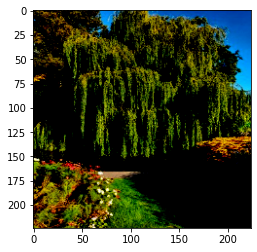

In [228]:
test_img='test_bd.jpeg'

test_img = tf.image.resize(Image.open(test_img), [224, 224])

test_img = tf.keras.applications.mobilenet_v2.preprocess_input(test_img)

plt.imshow(test_img)

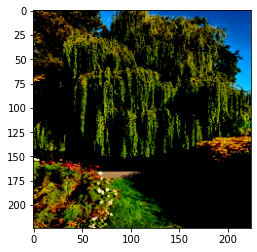

In [126]:
test_img='test_bd.jpeg'
test_img = np.array(Image.open(test_img))
resized_images = np.array(np.zeros((1, 224, 224, 3)))
resized_images[0] = tf.image.resize(test_img, [224, 224])
preprocessed_images = tf.keras.applications.mobilenet_v2.preprocess_input(resized_images)

plt.imshow(preprocessed_images[0])
plt.show()

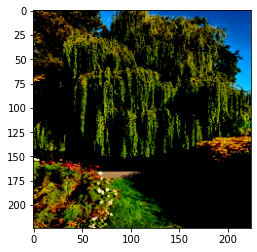

Result: bs
Probability: 0.6882455348968506


In [174]:
for idx,p in enumerate(predictions[0]):
    i = 1 if p >= 0.5 else 0
    result=train_ds.class_names[i]
    plt.imshow(preprocessed_images[idx])
    plt.show()
    print(f"Result: {result}\nProbability: {p}")

In [229]:
predictions = mobilenet_model.predict(preprocessed_image)

2022-06-15 00:21:36.550201: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


In [140]:


def prepare_image(file):
    img_path = './'
    img = image.load_img(img_path + file, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array_expanded_dims = np.expand_dims(img_array, axis=0)
    return tf.keras.applications.mobilenet.preprocess_input(img_array_expanded_dims)
preprocessed_image = prepare_image('test_bd.jpeg')
predictions = mobilenet_model.predict(preprocessed_image)

In [230]:
predictions

array([[0.71968675]], dtype=float32)

# 파일 확장자 확인

In [260]:
## 파일 확장자 확인코드

def check_images( s_dir, ext_list):
    bad_images=[]
    bad_ext=[]
    s_list= os.listdir(s_dir)
    for klass in s_list:
        klass_path=os.path.join (s_dir, klass)
        print ('processing class directory ', klass)
        if os.path.isdir(klass_path):
            file_list=os.listdir(klass_path)
            for f in file_list:               
                f_path=os.path.join (klass_path,f)
                tip = imghdr.what(f_path)
                if ext_list.count(tip) == 0:
                  bad_images.append(f_path)
                if os.path.isfile(f_path):
                    try:
                        img=cv2.imread(f_path)
                        shape=img.shape
                    except:
                        print('file ', f_path, ' is not a valid image file')
                        bad_images.append(f_path)
                else:
                    print('*** fatal error, you a sub directory ', f, ' in class directory ', klass)
        else:
            print ('*** WARNING*** you have files in ', s_dir, ' it should only contain sub directories')
    return bad_images, bad_ext

In [262]:
!ls {data_dir}

1.jpg   124.jpg 15.jpg  175.jpg 20.jpg  225.jpg 250.jpg 276.jpg 50.jpg  76.jpg
10.jpg  125.jpg 150.jpg 176.jpg 200.jpg 226.jpg 251.jpg 277.jpg 51.jpg  77.jpg
100.jpg 126.jpg 151.jpg 177.jpg 201.jpg 227.jpg 252.jpg 278.jpg 52.jpg  78.jpg
101.jpg 127.jpg 152.jpg 178.jpg 202.jpg 228.jpg 253.jpg 28.jpg  53.jpg  79.jpg
102.jpg 128.jpg 153.jpg 179.jpg 203.jpg 229.jpg 254.jpg 29.jpg  54.jpg  8.jpg
103.jpg 129.jpg 154.jpg 18.jpg  204.jpg 23.jpg  255.jpg 3.jpg   55.jpg  80.jpg
104.jpg 13.jpg  155.jpg 180.jpg 205.jpg 230.jpg 256.jpg 30.jpg  56.jpg  81.jpg
105.jpg 130.jpg 156.jpg 181.jpg 206.jpg 231.jpg 257.jpg 31.jpg  57.jpg  82.jpg
106.jpg 131.jpg 157.jpg 182.jpg 207.jpg 232.jpg 258.jpg 32.jpg  58.jpg  83.jpg
107.jpg 132.jpg 158.jpg 183.jpg 208.jpg 233.jpg 259.jpg 33.jpg  59.jpg  84.jpg
108.jpg 133.jpg 159.jpg 184.jpg 209.jpg 234.jpg 26.jpg  34.jpg  6.jpg   85.jpg
109.jpg 134.jpg 16.jpg  185.jpg 21.jpg  235.jpg 260.jpg 35.jpg  60.jpg  86.jpg
11.jpg  135.jpg 160.jpg 186.jpg 210.jpg 236.jpg 261.j

In [504]:
!ls test_images/test

1.jpeg  12.jpeg 15.jpeg 18.jpeg 20.jpeg 23.jpeg 3.jpeg  6.jpeg  9.jpeg
10.jpeg 13.jpeg 16.jpeg 19.jpeg 21.jpeg 24.jpeg 4.jpeg  7.jpeg
11.jpeg 14.jpeg 17.jpeg 2.jpeg  22.jpeg 25.jpeg 5.jpeg  8.jpeg


In [500]:
test_dir

'test_images/'

In [505]:
source_dir = 'test_images'
good_exts=['jpg', 'png', 'jpeg', 'gif', 'bmp' ] # list of acceptable extensions
bad_file_list, bad_ext_list=check_images(source_dir, good_exts)
if len(bad_file_list) !=0:
    print('improper image files are listed below')
    for i in range (len(bad_file_list)):
        print (bad_file_list[i])
else:
    print(' no improper image files were found')

processing class directory  .DS_Store
*** WARNING*** you have files in  test_images  it should only contain sub directories
processing class directory  test
 no improper image files were found


In [356]:
li = """./data_directory/rose_acacia/.DS_Store
./data_directory/rose_acacia/.DS_Store
./data_directory/rose_acacia/114.jpg
./data_directory/rose_acacia/107.jpg
./data_directory/rose_acacia/311.jpg
./data_directory/rose_acacia/21.jpg
./data_directory/rose_acacia/243.jpg
./data_directory/rose_acacia/282.jpg
./data_directory/rose_acacia/221.jpg
./data_directory/rose_acacia/140.jpg
./data_directory/rose_acacia/54.jpg
./data_directory/chrysanthemum/214.jpg
./data_directory/chrysanthemum/149.jpg
./data_directory/chrysanthemum/75.jpg
./data_directory/chrysanthemum/71.jpg
./data_directory/chrysanthemum/.DS_Store
./data_directory/chrysanthemum/.DS_Store
./data_directory/chrysanthemum/129.jpg
./data_directory/chrysanthemum/106.jpg
./data_directory/chrysanthemum/106.jpg
./data_directory/chrysanthemum/142.jpg
./data_directory/shiny_mint/.DS_Store
./data_directory/shiny_mint/.DS_Store
./data_directory/shiny_mint/371.jpg
./data_directory/shiny_mint/211.jpg
./data_directory/shiny_mint/101.jpg
./data_directory/shiny_mint/120.jpg
./data_directory/shiny_mint/283.jpg
./data_directory/shiny_mint/237.jpg""".split()

In [357]:
li[0]

'./data_directory/rose_acacia/.DS_Store'

In [358]:
for l in li:
    print(sp.getstatusoutput(f"rm {l}"))

(0, '')
(1, 'rm: ./data_directory/rose_acacia/.DS_Store: No such file or directory')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(1, 'rm: ./data_directory/chrysanthemum/.DS_Store: No such file or directory')
(0, '')
(0, '')
(1, 'rm: ./data_directory/chrysanthemum/106.jpg: No such file or directory')
(0, '')
(0, '')
(1, 'rm: ./data_directory/shiny_mint/.DS_Store: No such file or directory')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')
(0, '')


# 이미지 분류

In [416]:
data_directory = pathlib.Path(data_dir)
image_count = len(list(data_directory.glob('*/*.jpg'))) + len(list(data_directory.glob('*/*.jpeg')))

In [299]:
flower_li = os.listdir(data_dir)
flower_li.remove('.DS_Store')
flower_li

['rose_acacia', 'iris', 'silver_bell', 'chrysanthemum', 'shiny_mint']

In [300]:
flower_li.sort()

In [301]:
flower_li

['chrysanthemum', 'iris', 'rose_acacia', 'shiny_mint', 'silver_bell']

In [266]:
data_dir = './data_directory/'

## 5가지 식물 사용

### 각시붓꽃 iris

In [359]:
iris = os.listdir(f'{data_dir}{flower_li[1]}')
if '.DS_Store' in iris:
    iris.remove('.DS_Store')
iris

['373.jpeg',
 '236.jpeg',
 '47.jpeg',
 '324.jpeg',
 '261.jpeg',
 '518.jpeg',
 '148.jpeg',
 '10.jpeg',
 '298.jpeg',
 '332.jpeg',
 '277.jpeg',
 '365.jpeg',
 '220.jpeg',
 '559.jpeg',
 '109.jpeg',
 '51.jpeg',
 '467.jpeg',
 '522.jpeg',
 '488.jpeg',
 '172.jpeg',
 '349.jpeg',
 '430.jpeg',
 '92.jpeg',
 '125.jpeg',
 '575.jpeg',
 '84.jpeg',
 '426.jpeg',
 '563.jpeg',
 '133.jpeg',
 '308.jpeg',
 '471.jpeg',
 '164.jpeg',
 '534.jpeg',
 '543.jpeg',
 '113.jpeg',
 '406.jpeg',
 '390.jpeg',
 '144.jpeg',
 '514.jpeg',
 '451.jpeg',
 '282.jpeg',
 '328.jpeg',
 '502.jpeg',
 '152.jpeg',
 '447.jpeg',
 '294.jpeg',
 '555.jpeg',
 '410.jpeg',
 '369.jpeg',
 '386.jpeg',
 '191.jpeg',
 '26.jpeg',
 '484.jpeg',
 '257.jpeg',
 '312.jpeg',
 '579.jpeg',
 '129.jpeg',
 '71.jpeg',
 '200.jpeg',
 '345.jpeg',
 '580.jpeg',
 '88.jpeg',
 '67.jpeg',
 '216.jpeg',
 '353.jpeg',
 '187.jpeg',
 '538.jpeg',
 '492.jpeg',
 '168.jpeg',
 '30.jpeg',
 '241.jpeg',
 '304.jpeg',
 '240.jpeg',
 '305.jpeg',
 '186.jpeg',
 '539.jpeg',
 '493.jpeg',
 '169.jpe

In [360]:
len(iris)

585

In [305]:
iris_dir = f'{data_dir}{flower_li[1]}/'

In [306]:
iris_dir

'./data_directory/iris/'

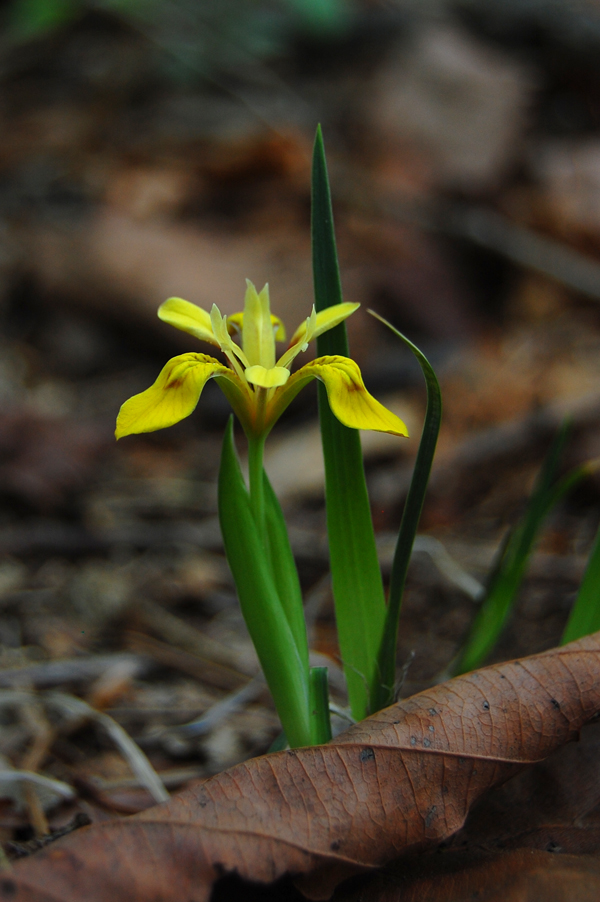

In [307]:
Image.open(iris_dir+iris[0])

### 은방울꽃 silver_bell

In [368]:
silver_bell = os.listdir(f'{data_dir}{flower_li[4]}')
if '.DS_Store' in iris:
    silver_bell.remove('.DS_Store')
silver_bell

['236.jpeg',
 '47.jpeg',
 '261.jpeg',
 '148.jpeg',
 '277.jpeg',
 '220.jpeg',
 '109.jpeg',
 '51.jpeg',
 '172.jpeg',
 '92.jpeg',
 '125.jpeg',
 '84.jpeg',
 '133.jpeg',
 '164.jpeg',
 '113.jpeg',
 '144.jpeg',
 '152.jpeg',
 '105.jpeg',
 '191.jpeg',
 '26.jpeg',
 '257.jpeg',
 '129.jpeg',
 '71.jpeg',
 '200.jpeg',
 '67.jpeg',
 '216.jpeg',
 '187.jpeg',
 '30.jpeg',
 '241.jpeg',
 '186.jpeg',
 '169.jpeg',
 '31.jpeg',
 '217.jpeg',
 '89.jpeg',
 '66.jpeg',
 '201.jpeg',
 '128.jpeg',
 '70.jpeg',
 '256.jpeg',
 '190.jpeg',
 '27.jpeg',
 '104.jpeg',
 '153.jpeg',
 '145.jpeg',
 '112.jpeg',
 '165.jpeg',
 '85.jpeg',
 '1.jpeg',
 '132.jpeg',
 '93.jpeg',
 '124.jpeg',
 '173.jpeg',
 '108.jpeg',
 '50.jpeg',
 '221.jpeg',
 '276.jpeg',
 '149.jpeg',
 '11.jpeg',
 '260.jpeg',
 '46.jpeg',
 '237.jpeg',
 '115.jpeg',
 '142.jpeg',
 '154.jpeg',
 '103.jpeg',
 '197.jpeg',
 '178.jpeg',
 '20.jpeg',
 '98.jpeg',
 '77.jpeg',
 '206.jpeg',
 '139.jpeg',
 '61.jpeg',
 '210.jpeg',
 '181.jpeg',
 '36.jpeg',
 '247.jpeg',
 '230.jpeg',
 '119.jpeg'

In [369]:
len(silver_bell)

266

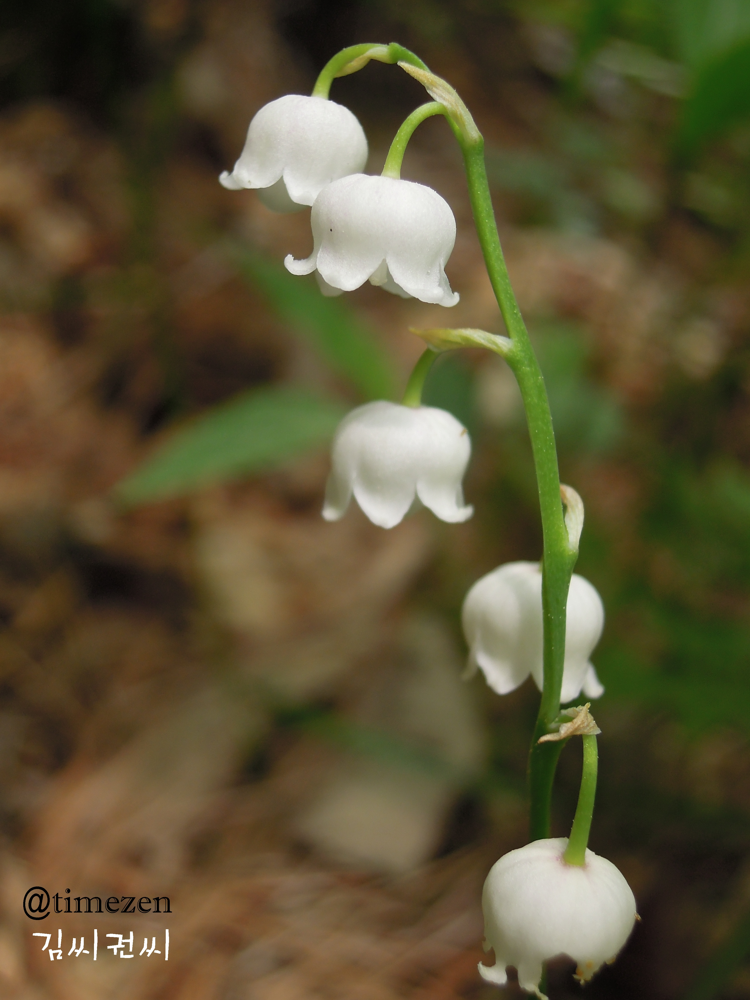

In [319]:
silver_bell_dir = f'{data_dir}{flower_li[4]}/'
Image.open(silver_bell_dir+ silver_bell[3])

### 꽃향유 shiny_mint

In [370]:
flower = flower_li[3]
shiny_mint = os.listdir(f'{data_dir}{flower}')
if '.DS_Store' in iris:
    shiny_mint.remove('.DS_Store')
shiny_mint

['63.jpg',
 '189.jpg',
 '77.jpg',
 '162.jpg',
 '176.jpg',
 '88.jpg',
 '348.jpg',
 '360.jpg',
 '406.jpg',
 '412.jpg',
 '374.jpg',
 '228.jpg',
 '214.jpg',
 '200.jpg',
 '201.jpg',
 '215.jpg',
 '229.jpg',
 '413.jpg',
 '375.jpg',
 '361.jpg',
 '407.jpg',
 '349.jpg',
 '177.jpg',
 '89.jpg',
 '163.jpg',
 '188.jpg',
 '76.jpg',
 '62.jpg',
 '74.jpg',
 '60.jpg',
 '48.jpg',
 '149.jpg',
 '175.jpg',
 '161.jpg',
 '388.jpg',
 '439.jpg',
 '377.jpg',
 '411.jpg',
 '405.jpg',
 '363.jpg',
 '203.jpg',
 '217.jpg',
 '216.jpg',
 '202.jpg',
 '404.jpg',
 '362.jpg',
 '376.jpg',
 '410.jpg',
 '438.jpg',
 '389.jpg',
 '160.jpg',
 '174.jpg',
 '148.jpg',
 '49.jpg',
 '61.jpg',
 '75.jpg',
 '59.jpg',
 '71.jpg',
 '65.jpg',
 '170.jpg',
 '164.jpg',
 '158.jpg',
 '399.jpg',
 '414.jpg',
 '372.jpg',
 '366.jpg',
 '400.jpg',
 '428.jpg',
 '206.jpg',
 '212.jpg',
 '213.jpg',
 '207.jpg',
 '429.jpg',
 '367.jpg',
 '401.jpg',
 '415.jpg',
 '373.jpg',
 '398.jpg',
 '159.jpg',
 '165.jpg',
 '171.jpg',
 '64.jpg',
 '70.jpg',
 '58.jpg',
 '8.jpg',


In [371]:
len(shiny_mint)

493

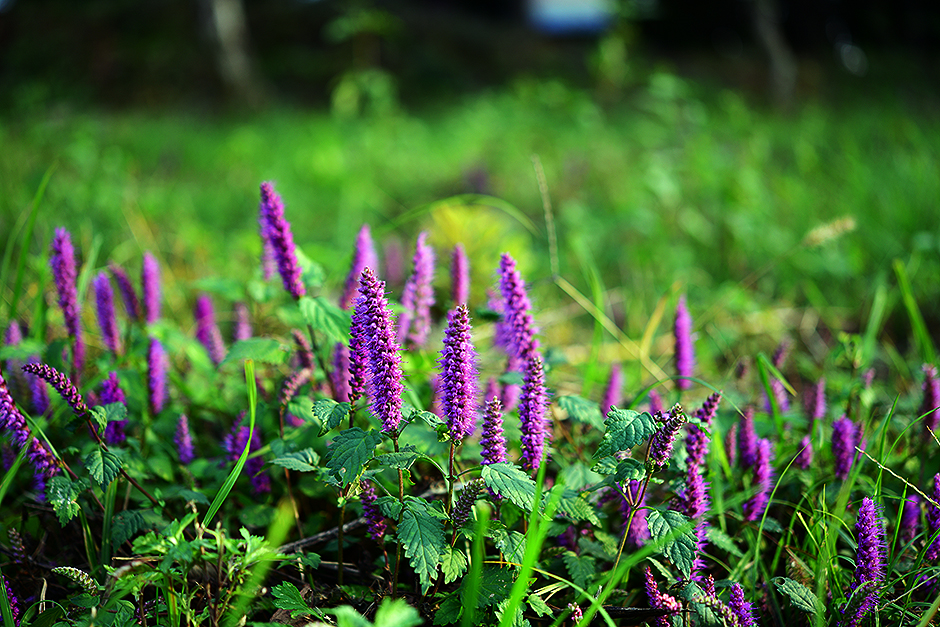

In [364]:
shiny_mint_dir = f'{data_dir}{flower}/'
Image.open(shiny_mint_dir+ shiny_mint[3])

### 꽃아까시아나무 rose_acacia

In [327]:
flower_li

['chrysanthemum', 'iris', 'rose_acacia', 'shiny_mint', 'silver_bell']

In [372]:
flower = flower_li[2]
rose_acacia = os.listdir(f'{data_dir}{flower}')
if '.DS_Store' in iris:
    rose_acacia.remove('.DS_Store')
rose_acacia

['63.jpg',
 '189.jpg',
 '77.jpg',
 '162.jpg',
 '176.jpg',
 '88.jpg',
 '348.jpg',
 '360.jpg',
 '406.jpg',
 '374.jpg',
 '228.jpg',
 '214.jpg',
 '200.jpg',
 '201.jpg',
 '215.jpg',
 '229.jpg',
 '375.jpg',
 '361.jpg',
 '349.jpg',
 '177.jpg',
 '89.jpg',
 '163.jpg',
 '188.jpg',
 '76.jpg',
 '62.jpg',
 '74.jpg',
 '60.jpg',
 '48.jpg',
 '149.jpg',
 '175.jpg',
 '161.jpg',
 '388.jpg',
 '377.jpg',
 '405.jpg',
 '363.jpg',
 '203.jpg',
 '217.jpg',
 '216.jpg',
 '202.jpg',
 '404.jpg',
 '362.jpg',
 '376.jpg',
 '389.jpg',
 '160.jpg',
 '174.jpg',
 '148.jpg',
 '49.jpg',
 '61.jpg',
 '75.jpg',
 '59.jpg',
 '71.jpg',
 '65.jpg',
 '170.jpg',
 '164.jpg',
 '158.jpg',
 '399.jpg',
 '372.jpg',
 '366.jpg',
 '400.jpg',
 '206.jpg',
 '212.jpg',
 '213.jpg',
 '207.jpg',
 '367.jpg',
 '401.jpg',
 '373.jpg',
 '398.jpg',
 '159.jpg',
 '165.jpg',
 '171.jpg',
 '64.jpg',
 '70.jpg',
 '58.jpg',
 '8.jpg',
 '198.jpg',
 '66.jpg',
 '72.jpg',
 '167.jpg',
 '99.jpg',
 '173.jpg',
 '403.jpg',
 '365.jpg',
 '371.jpg',
 '359.jpg',
 '211.jpg',
 '2

In [373]:
len(rose_acacia)

397

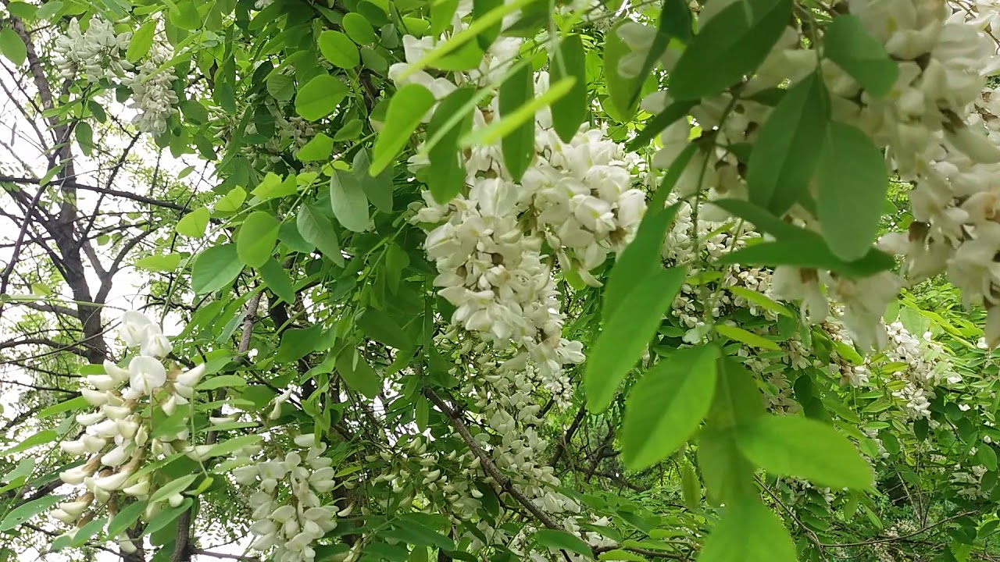

In [367]:
rose_acacia_dir = f'{data_dir}{flower}/'
Image.open(rose_acacia_dir+rose_acacia[0])

### 국화 chrysanthemum

In [374]:
flower = flower_li[0]
chrysanthemum = os.listdir(f'{data_dir}{flower}')
if '.DS_Store' in iris:
    chrysanthemum.remove('.DS_Store')
len(chrysanthemum)

240

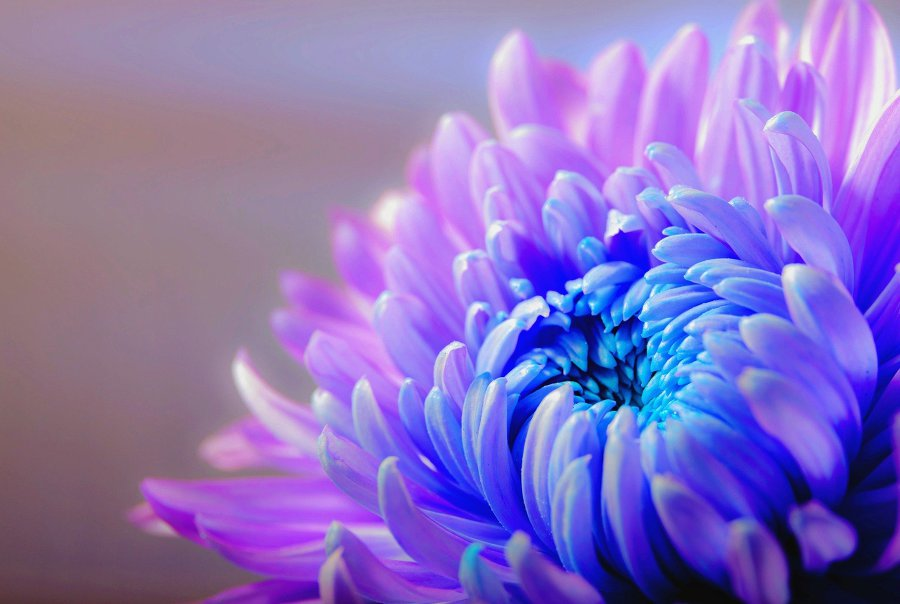

In [375]:
chrysanthemum_dir = f'{data_dir}{flower}/'
Image.open(chrysanthemum_dir+ chrysanthemum[0])

## dataset 생성

In [257]:
batch_size = 32
img_height = 224
img_width = 224

In [376]:
train_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset='training',
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size
)

Found 1981 files belonging to 5 classes.
Using 1585 files for training.


In [388]:
train_ds.class_names

['chrysanthemum', 'iris', 'rose_acacia', 'shiny_mint', 'silver_bell']

In [384]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 1981 files belonging to 5 classes.
Using 396 files for validation.


In [385]:
class_names_length = len(train_ds.class_names)
print(class_names_length)

5


2022-06-15 15:49:38.090317: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile


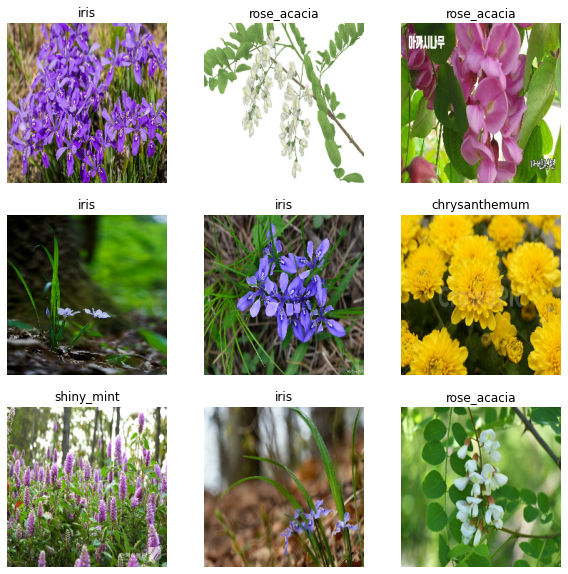

In [391]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i+1)
        plt.imshow(images[i].numpy().astype('uint8'))
        plt.title(train_ds.class_names[labels[i]])
        plt.axis('off')

In [392]:
for image_batch, labels_batch in train_ds:
    print(image_batch.shape)
    print(labels_batch.shape)
    break

(32, 224, 224, 3)
(32,)


## 모델 생성

In [393]:
normalization_layer = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)

In [394]:
resizing_layer = tf.keras.layers.experimental.preprocessing.Resizing(height=img_height, width=img_width)

In [395]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [396]:
num_classes = class_names_length

model = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.Rescaling(1./255),
  tf.keras.layers.Conv2D(32, 3, activation='relu'),
  tf.keras.layers.MaxPooling2D(),
  tf.keras.layers.Conv2D(32, 3, activation='relu'),
  tf.keras.layers.MaxPooling2D(),
  tf.keras.layers.Conv2D(32, 3, activation='relu'),
  tf.keras.layers.MaxPooling2D(),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dense(num_classes)
])

In [397]:
model.compile(
  optimizer='adam',
  loss=tf.losses.SparseCategoricalCrossentropy(from_logits=True),
  metrics=['accuracy'])

### 모델 학습

In [398]:
model.fit(train_ds, validation_data=val_ds, epochs=3)

Epoch 1/3


2022-06-15 15:50:26.208734: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-06-15 15:50:26.925883: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile


50/50 [==============================] - ETA: 0s - loss: 1.4642 - accuracy: 0.3666

2022-06-15 15:50:30.867570: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


50/50 [==============================] - 6s 101ms/step - loss: 1.4642 - accuracy: 0.3666 - val_loss: 1.1732 - val_accuracy: 0.5278
Epoch 2/3
50/50 [==============================] - 3s 56ms/step - loss: 0.9425 - accuracy: 0.6568 - val_loss: 0.8317 - val_accuracy: 0.6919
Epoch 3/3
50/50 [==============================] - 3s 58ms/step - loss: 0.6312 - accuracy: 0.7785 - val_loss: 0.7120 - val_accuracy: 0.7652


# 이미지분류 - tf.data 사용

In [405]:
str(data_dir+'*/*')

'./data_directory/*/*'

In [563]:
data_dir

'./data_directory/'

In [564]:
list_ds = tf.data.Dataset.list_files(str(data_dir+'*/*'), shuffle=False)
list_ds = list_ds.shuffle(image_count, reshuffle_each_iteration=False)

In [566]:
for f in list_ds.take(5):
    print(f.numpy())

b'./data_directory/iris/6.jpeg'
b'./data_directory/rose_acacia/68.jpg'
b'./data_directory/shiny_mint/173.jpg'
b'./data_directory/chrysanthemum/223.jpg'
b'./data_directory/silver_bell/138.jpeg'


In [567]:
class_names = np.array(sorted([item.name for item in data_directory.glob('*') if item.name != ".DS_Store"]))
print(class_names)

['chrysanthemum' 'iris' 'rose_acacia' 'shiny_mint' 'silver_bell']


### 학습데이터셋 생성

In [578]:
val_size = int(image_count * 0.2)
train_ds = list_ds.skip(val_size)
val_ds = list_ds.take(val_size)

In [569]:
print(tf.data.experimental.cardinality(train_ds).numpy())
print(tf.data.experimental.cardinality(val_ds).numpy())

1585
396


In [427]:
def get_label(file_path):
    # convert the path to a list of path components
    parts = tf.strings.split(file_path, os.path.sep)
    # The second to last is the class-directory
    one_hot = parts[-2] == class_names
    # Integer encode the label
    return tf.argmax(one_hot)

In [428]:
def decode_img(img):
    # convert the compressed string to a 3D uint8 tensor
    img = tf.io.decode_jpeg(img, channels=3)
    # resize the image to the desired size
    return tf.image.resize(img, [img_height, img_width])

In [429]:
def process_path(file_path):
    label = get_label(file_path)
    # load the raw data from the file as a string
    img = tf.io.read_file(file_path)
    img = decode_img(img)
    return img, label

In [579]:
train_ds = train_ds.map(process_path, num_parallel_calls=AUTOTUNE)
val_ds = val_ds.map(process_path, num_parallel_calls=AUTOTUNE)

In [580]:
for image, label in train_ds.take(1):
    print("Image shape: ", image.numpy().shape)
    print("Label: ", label.numpy())

Image shape:  (224, 224, 3)
Label:  3


In [581]:
def configure_for_performance(ds):
    ds = ds.cache()
    ds = ds.shuffle(buffer_size=1000)
    ds = ds.batch(batch_size)
    ds = ds.prefetch(buffer_size=AUTOTUNE)
    return ds

train_ds = configure_for_performance(train_ds)
val_ds = configure_for_performance(val_ds)


2022-06-16 00:48:15.281869: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile
2022-06-16 00:48:15.869787: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


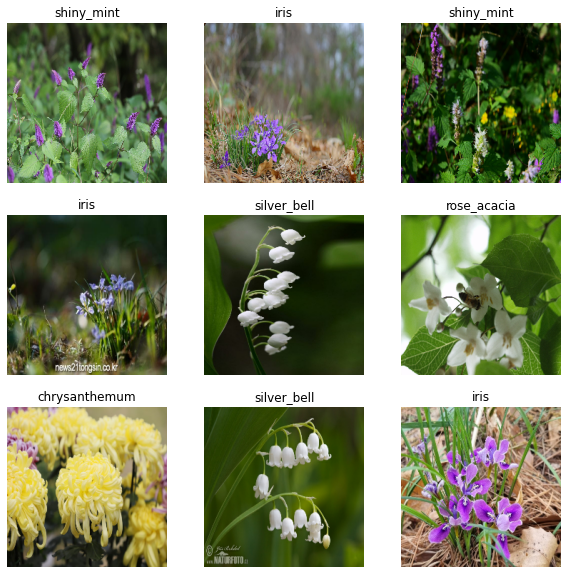

In [582]:
image_batch, label_batch = next(iter(train_ds))

plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image_batch[i].numpy().astype("uint8"))
    label = label_batch[i]
    plt.title(class_names[label])
    plt.axis("off")

### 모델 학습

In [437]:
model.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_3 (Rescaling)     (None, 224, 224, 3)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 111, 111, 32)     0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 109, 109, 32)      9248      
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 54, 54, 32)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 52, 52, 32)      

In [436]:
model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=3
)

Epoch 1/3


2022-06-15 22:46:21.454278: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-06-15 22:46:22.600588: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile


50/50 [==============================] - ETA: 0s - loss: 0.4994 - accuracy: 0.8315

2022-06-15 22:46:26.884300: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


50/50 [==============================] - 7s 92ms/step - loss: 0.4994 - accuracy: 0.8315 - val_loss: 0.4016 - val_accuracy: 0.8636
Epoch 2/3
50/50 [==============================] - 3s 58ms/step - loss: 0.3066 - accuracy: 0.9016 - val_loss: 0.3961 - val_accuracy: 0.8460
Epoch 3/3
50/50 [==============================] - 3s 58ms/step - loss: 0.1900 - accuracy: 0.9438 - val_loss: 0.3873 - val_accuracy: 0.8535


### 모델 평가

In [619]:
test_directory = pathlib.Path(test_dir)

In [ ]:
test_images = os.listdir(test_dir)
test_images.remove('.DS_Store')
test_images_cnt = len(test_images)

test_dir = 'test_images/'

test_ds = tf.data.Dataset.list_files(str(test_dir+'*'), shuffle=False)
test_ds = test_ds.shuffle(test_images_cnt, reshuffle_each_iteration=False)

In [615]:
for f in test_ds.take(5):
    print(f.numpy())

b'test_images/chrysanthemum/14.jpeg'
b'test_images/chrysanthemum/15.jpeg'
b'test_images/chrysanthemum/12.jpeg'
b'test_images/iris/6.jpeg'
b'test_images/iris/9.jpeg'


In [621]:
test_class_names = np.array(sorted([item.name for item in test_directory.glob('*') if item.name != '.DS_Store']))
print(test_class_names)

['chrysanthemum' 'iris' 'rose_acacia' 'shiny_mint' 'silver_bell']


In [622]:
tf.data.experimental.cardinality(test_ds).numpy()

25

In [623]:
test_ds = test_ds.map(process_path, num_parallel_calls=AUTOTUNE)

In [624]:
test_ds = configure_for_performance(test_ds)

In [625]:
for image, label in test_ds.take(1):
    print(image.numpy().shape)

(25, 224, 224, 3)


In [626]:
image_batch, label_batch = next(iter(test_ds))

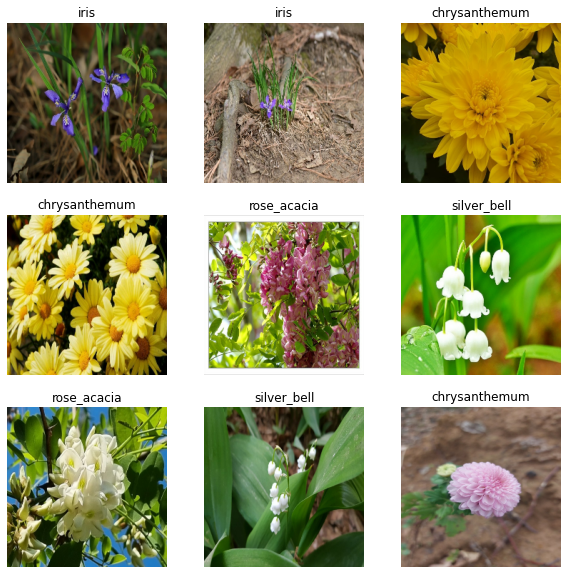

In [627]:
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image_batch[i].numpy().astype("uint8"))
    label = label_batch[i]
    plt.title(class_names[label])
    plt.axis("off")

In [645]:
predictions_score = model.predict(test_ds)
score = tf.nn.softmax(predictions_score[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score))
)

This image most likely belongs to silver_bell with a 95.19 percent confidence.


In [649]:
#Retrieve a batch of images from the test set
image_batch, label_batch = test_ds.as_numpy_iterator().next()
predictions = model.predict_on_batch(image_batch).flatten()

In [653]:
predictions = model.predict_on_batch(image_batch)

In [660]:
predictions[1]

array([ 3.0393379,  2.087596 ,  3.471487 ,  5.9884567, -1.5048256],
      dtype=float32)

Labels:
 [4 3 2 1 0 2 1 1 3 4 2 4 3 1 4 0 0 3 0 3 2 0 2 1 4]


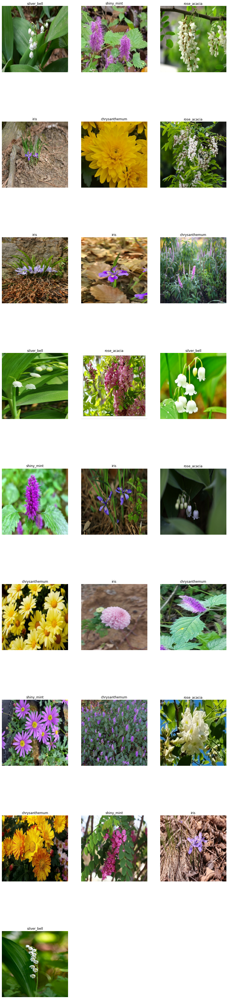

In [666]:
print('Labels:\n', label_batch)

plt.figure(figsize=(15, 70))
for i in range(25):
  ax = plt.subplot(9, 3, i + 1)
  plt.imshow(image_batch[i].astype("uint8"))
  plt.title(class_names[np.argmax(predictions[i])])
  plt.axis("off")

In [673]:
answer = label_batch

In [674]:
pred = list(map(np.argmax,predictions))

In [675]:
print(f"accuracy: {accuracy_score(answer,pred):.2%}")

accuracy: 72.00%
